In [1]:
import ee
import geemap
import numpy as np
import matplotlib.pyplot as plt
import os
import pandas as pd
import requests
from rasterio.warp import transform
import xarray as xr
# Initialize the Earth Engine module.
ee.Initialize()

In [2]:
# path to directory where you want your output .shp files
OUTpath = '/nfs/attic/dfh/2020_NPRB/data/gis/ak_huc4/'

# These are the min and max corners of AK
#// Input the minimum lat, lower left corner
minLat = 49.5
#// Input the minimum long, lower left corner
minLong = -179
#// Input the max lat, upper right corner
maxLat = 71.5
#// Input the max Long, upper right corner
maxLong = -128

#USGS HUC4 watershed boundary dataset
dataset = ee.FeatureCollection('USGS/WBD/2017/HUC04').filterBounds(ee.Geometry.Rectangle(**{
    'coords':[minLong,minLat,maxLong,maxLat],'proj': 'EPSG:4326', 'geodesic':True,
}));

#export file
filename = os.path.join(OUTpath, 'ak_huc4.shp')
geemap.ee_to_shp(dataset, filename=filename)

# WWF HydroSHEDS for the yukon basin 
basin3 = ee.FeatureCollection("WWF/HydroSHEDS/v1/Basins/hybas_3")
yu = basin3.filter(ee.Filter.eq('HYBAS_ID', 8030005510))

#export file
filename = os.path.join(OUTpath, 'ak_yukon.shp')
geemap.ee_to_shp(yu, filename=filename)

Generating URL ...
Please wait ...
Data downloaded to /nfs/attic/dfh/2020_NPRB/data/gis/ak_huc4/ak_huc4.shp
Generating URL ...
Please wait ...
Data downloaded to /nfs/attic/dfh/2020_NPRB/data/gis/ak_huc4/ak_yukon.shp


# visualize arctic domains

### BEAU = 1906
### BRIS = 1903
### CHUK = 1905
### YUKO = 1904

![title](huc4.png)

In [3]:
import geopandas as gpd
import folium
import matplotlib.pyplot as plt
from shapely import geometry as sgeom
import numpy as np

m = folium.Map(zoom_start=15)

In [28]:
#yukon shapefile
path = '/nfs/attic/dfh/2020_NPRB/data/gis/YUKO/yuko_final.shp'

YUKO = gpd.read_file(path)

(-175.0, -125.0)

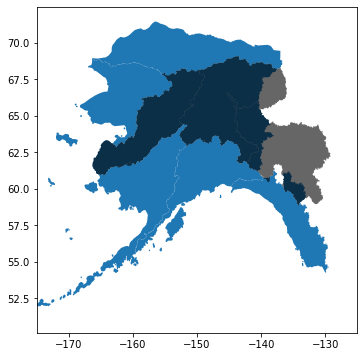

In [29]:
#USGS shapefile
path = '/nfs/attic/dfh/2020_NPRB/data/gis/ak_huc4/ak_huc4.shp'

huc4 = gpd.read_file(path)

#plot
fig, ax = plt.subplots(figsize=(14,6))

huc4.plot(ax=ax)
YUKO.plot(ax=ax,color='k',alpha = 0.6)

ax.set_xlim([-175,-125])


In [6]:
huc4

,sourcedata,areaacres,sourcefeat,shape_leng,huc4,states,sourceorig,shape_area,areasqkm,name,tnmid,metasource,loaddate,gnis_id,geometry
0,None,87529860.67,None,154.264209755835,1903,AK,None,55.8583986273122,354221.09,Southwest Alaska,{385907E5-EED5-4B90-97A3-403EC8B96CF6},None,20120611075459,None,"MULTIPOLYGON (((-179.22966 51.27641, -179.2296..."
1,None,50842423.05,None,71.7881563969554,1905,AK,None,41.1532182818327,205752.17,Northwest Alaska,{84E9AA98-74D8-49D9-BE79-A44C89A3EFCE},None,20120611075459,None,"MULTIPOLYGON (((-171.97620 63.54493, -171.9761..."
2,None,65891558.47,None,89.7875033645983,1902,"AK,CN",None,43.8579393633345,266653.91,South Central Alaska,{9F60218E-B1CA-4EAF-8931-CA52BDA34AB3},None,20120611075459,None,"MULTIPOLYGON (((-159.64785 55.89460, -159.6477..."
3,None,58057872.42,None,69.9847136475445,1909,AK,None,43.9234625641559,234952.08,Lower Yukon River,{5BB448D5-84DF-4F58-BE37-0DCDDFD8FA13},None,20140306102205,None,"POLYGON ((-152.45167 68.23090, -152.44777 68.2..."
4,None,59062950.27,None,74.3477185137574,1906,"AK,CN",None,54.6612713411946,239019.49,Arctic Alaska,{E510FB22-3CEC-4490-B6D4-1A2EF616217E},None,20160729125009,None,"POLYGON ((-155.77282 71.28410, -155.77268 71.2..."
5,None,24611933.1,None,58.6544013088836,1907,"AK,CN",None,17.7296933304518,99601.05,Upper Yukon River,{956E7D81-1B76-47C7-85B1-72BB2378CD8D},None,20160801095414,None,"MULTIPOLYGON (((-145.36509 66.49663, -145.3641..."
6,None,68226189.05,None,83.8992853629476,1908,"AK,CN",None,54.2238494674056,276101.84,Middle Yukon River,{9235AEC9-3FE1-4E6C-B081-3B80209521EF},None,20160801095422,None,"POLYGON ((-143.73099 69.07800, -143.72975 69.0..."
7,None,47061887.71,None,57.9428556458048,1901,"AK,CN",None,28.8715585065226,190452.87,Southeast Alaska,{2836BE66-8D09-4A23-819A-032ACFC07EC9},None,20170110095538,None,"MULTIPOLYGON (((-144.71206 59.78693, -144.7120..."


## Beaufort Sea domain

In [16]:
BEAU = huc4[huc4.huc4 == '1906']

#check bounding box extent
box_sgeom = sgeom.box(BEAU.bounds.minx.values[0]-.2, BEAU.bounds.miny.values[0]-.2, BEAU.bounds.maxx.values[0]+.2, BEAU.bounds.maxy.values[0]+.2)
box_gdf = gpd.GeoDataFrame(geometry=[box_sgeom], crs=huc4.crs)

#save out domain GeoJSON
outpath = '/nfs/attic/dfh/2020_NPRB/data/gis/BEAU/BEAU.json'
BEAU.to_file(outpath, driver="GeoJSON")
#save out domain shapefile
outpath = '/nfs/attic/dfh/2020_NPRB/data/gis/BEAU/BEAU.shp'
BEAU.to_file(outpath)

# plot 
folium.GeoJson(BEAU).add_to(m)
folium.GeoJson(box_gdf).add_to(m)
display(m)  

#print domain boundaries for SnowModel
print('latmax =',np.round(BEAU.bounds.maxy.values-.1,2))
print('latmin =',np.round(BEAU.bounds.miny.values-.6,2))
print('lonmax =',np.round(BEAU.bounds.maxx.values+.2,2))
print('lonmin =',np.round(BEAU.bounds.minx.values-.2,2))

latmax = [71.34]
latmin = [67.14]
lonmax = [-136.48]
lonmin = [-166.51]


In [ ]:
import io
from PIL import Image

img_data = m._to_png(5)
img = Image.open(io.BytesIO(img_data))
img.save('image.png')

## Bristol Bay domain

In [17]:
bris = huc4[huc4.huc4 == '1903']
# only select inland geometry 
gdf = gpd.GeoDataFrame(bris.explode().geometry.values,columns={'geometry'},crs = huc4.crs)
gdf['area']=gdf.geometry.area
gdf['huc4']=bris.huc4.values[0]
gdf['states']=bris.states.values[0]
gdf['name']=bris.name.values[0]
BRIS=gdf.loc[gdf.area==gdf.area.max()]

#save out domain GeoJSON
outpath = '/nfs/attic/dfh/2020_NPRB/data/gis/BRIS/BRIS.json'
BRIS.to_file(outpath, driver="GeoJSON")

#check bounding box extent
box_sgeom = sgeom.box(BRIS.bounds.minx.values[0]-.2, BRIS.bounds.miny.values[0]-.2, BRIS.bounds.maxx.values[0]+.2, BRIS.bounds.maxy.values[0]+.2)
box_gdf = gpd.GeoDataFrame(geometry=[box_sgeom], crs=huc4.crs)

#plot
n = folium.Map(zoom_start=30)
folium.GeoJson(BRIS).add_to(n)
folium.GeoJson(box_gdf).add_to(n)
display(n)  

#print domain boundaries for SnowModel
print('latmax =',np.round(BRIS.bounds.maxy.values-.1,2))
print('latmin =',np.round(BRIS.bounds.miny.values-.6,2))
print('lonmax =',np.round(BRIS.bounds.maxx.values+.2,2))
print('lonmin =',np.round(BRIS.bounds.minx.values-.2,2))

<ipython-input-17-a751c844697b>:4: UserWarning: Geometry is in a geographic CRS. Results from 'area' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  gdf['area']=gdf.geometry.area
<ipython-input-17-a751c844697b>:8: UserWarning: Geometry is in a geographic CRS. Results from 'area' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  BRIS=gdf.loc[gdf.area==gdf.area.max()]


latmax = [64.32]
latmin = [53.74]
lonmax = [-151.31]
lonmin = [-165.71]


## Chukchi Sea domain

In [18]:
chuk = huc4[huc4.huc4 == '1905']
# only select inland geometry 
gdf = gpd.GeoDataFrame(chuk.explode().geometry.values,columns={'geometry'},crs = huc4.crs)
gdf['area']=gdf.geometry.area
gdf['huc4']=chuk.huc4.values[0]
gdf['states']=chuk.states.values[0]
gdf['name']=chuk.name.values[0]
CHUK=gdf.loc[gdf.area==gdf.area.max()]

#save out domain GeoJSON
outpath = '/nfs/attic/dfh/2020_NPRB/data/gis/CHUK/CHUK.json'
CHUK.to_file(outpath, driver="GeoJSON")

#check bounding box extent
box_sgeom = sgeom.box(CHUK.bounds.minx.values-.2, CHUK.bounds.miny.values[0]-.2, CHUK.bounds.maxx.values[0]+.2, CHUK.bounds.maxy.values[0]+.2)
box_gdf = gpd.GeoDataFrame(geometry=[box_sgeom], crs=huc4.crs)

#plot
o = folium.Map(zoom_start=30)
folium.GeoJson(CHUK).add_to(o)
folium.GeoJson(box_gdf).add_to(o)
display(o)  

#print domain boundaries for SnowModel
print('latmax =',np.round(CHUK.bounds.maxy.values-.1,2))
print('latmin =',np.round(CHUK.bounds.miny.values-.6,2))
print('lonmax =',np.round(CHUK.bounds.maxx.values+.2,2))
print('lonmin =',np.round(CHUK.bounds.minx.values-.2,2))

<ipython-input-18-54e882683bfe>:4: UserWarning: Geometry is in a geographic CRS. Results from 'area' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  gdf['area']=gdf.geometry.area
<ipython-input-18-54e882683bfe>:8: UserWarning: Geometry is in a geographic CRS. Results from 'area' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  CHUK=gdf.loc[gdf.area==gdf.area.max()]


latmax = [68.82]
latmin = [62.23]
lonmax = [-153.64]
lonmin = [-168.45]


## Yukon domain

In [30]:
#check bounding box extent
box_sgeom = sgeom.box(YUKO.bounds.minx.values[0]-.2, YUKO.bounds.miny.values[0]-.2, YUKO.bounds.maxx.values[0]+.2, YUKO.bounds.maxy.values[0]+.2)
box_gdf = gpd.GeoDataFrame(geometry=[box_sgeom], crs=huc4.crs)

#save out domain GeoJSON
outpath = '/nfs/attic/dfh/2020_NPRB/data/gis/YUKO/YUKO.json'
YUKO.to_file(outpath, driver="GeoJSON")

#plot
p = folium.Map(zoom_start=30)
folium.GeoJson(YUKO).add_to(p)
folium.GeoJson(box_gdf).add_to(p)
display(p)  

#print domain boundaries for SnowModel
print('latmax =',np.round(YUKO.bounds.maxy.values-.1,2))
print('latmin =',np.round(YUKO.bounds.miny.values-.6,2))
print('lonmax =',np.round(YUKO.bounds.maxx.values+.2,2))
print('lonmin =',np.round(YUKO.bounds.minx.values-.2,2))

latmax = [68.98]
latmin = [58.25]
lonmax = [-129.]
lonmin = [-166.48]


# next step
**Plug the bound for these domains into the 01_DomainBounds2json code**